In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as sts
from IPython.display import display, Image
%matplotlib inline
import seaborn as sns
sns.set()
import warnings
warnings.simplefilter('ignore')


%pylab inline
%config InlineBackend.figure_format = 'svg' 
from pylab import rcParams
rcParams['figure.figsize'] = 11,9

Populating the interactive namespace from numpy and matplotlib


In [3]:
hr = pd.read_csv('HR.csv')

In [4]:
hr.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,sales,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


In [5]:
hr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
satisfaction_level       14999 non-null float64
last_evaluation          14999 non-null float64
number_project           14999 non-null int64
average_montly_hours     14999 non-null int64
time_spend_company       14999 non-null int64
Work_accident            14999 non-null int64
left                     14999 non-null int64
promotion_last_5years    14999 non-null int64
sales                    14999 non-null object
salary                   14999 non-null object
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB


## Рассчитать основные статистики для переменных (среднее,медиана,мода,мин/макс,сред.отклонение)

In [10]:
hr.describe()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years
count,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000
mean,0.612834,0.716102,3.803054,201.050337,3.498233,0.144610,0.238083,0.021268
std,0.248631,0.171169,1.232592,49.943099,1.460136,0.351719,0.425924,0.144281
min,0.090000,0.360000,2.000000,96.000000,2.000000,0.000000,0.000000,0.000000
25%,0.440000,0.560000,3.000000,156.000000,3.000000,0.000000,0.000000,0.000000
50%,0.640000,0.720000,4.000000,200.000000,3.000000,0.000000,0.000000,0.000000
75%,0.820000,0.870000,5.000000,245.000000,4.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,7.000000,310.000000,10.000000,1.000000,1.000000,1.000000


    Можно заметить, что в компании не очень высокий уровень удовлетворенности работой, однако, судя по последним оценкам, он несколько повысился. Компания имеет достаточно много проектов, чтобы занять людей, возможно даже слишком много - по 3 на сотрудника. Возможно такая большая нагрузка отталкивает людей? Посмотрим на количество часов в месяц  -  в среднем 200. Это примерно 10 в день. Наверно, большое количество проектов заставляет людей много работать и перерабатывать. Чрезмерный нагрузки могут оттолкнуть людей. Состоит компания в основном из      работников, которые не очень много проработали в ней:75% всех работников проработали меньше 4 лет. Что интересно, что среднее и медиана количества лет в компании - 3, что говорит о том, что нет большой текучки в компании. Однако, если посмотрим, максимальное количество лет в компании - 10, в то время как большинство работают 4. Возможно после 4 лет людям начинает чего то недоставать и они уходят, проработав именно такой срок. Посмотрев на promotion_last_5years, можем предположить, что именно в этом причина: этот показатель очень маленький, в компании практически не было повышений. Возможно, проработав в компании 4 года,люди хотят какого-то повышения по карьерной лестнице, не получают его, и, даже несмотря на достаточно высокую оценку работы, уходят.

In [11]:
hr.median()

satisfaction_level         0.64
last_evaluation            0.72
number_project             4.00
average_montly_hours     200.00
time_spend_company         3.00
Work_accident              0.00
left                       0.00
promotion_last_5years      0.00
dtype: float64

In [12]:
hr.mode()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,sales,salary
0,0.1,0.55,4.0,135,3.0,0.0,0.0,0.0,sales,low
1,NaN,NaN,NaN,156,NaN,NaN,NaN,NaN,NaN,NaN


## Рассчитать и визуализировать корреляционную матрицу для переменных

In [13]:
corr = hr.corr()
corr

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years
satisfaction_level,1.000000,0.105021,-0.142970,-0.020048,-0.100866,0.058697,-0.388375,0.025605
last_evaluation,0.105021,1.000000,0.349333,0.339742,0.131591,-0.007104,0.006567,-0.008684
number_project,-0.142970,0.349333,1.000000,0.417211,0.196786,-0.004741,0.023787,-0.006064
average_montly_hours,-0.020048,0.339742,0.417211,1.000000,0.127755,-0.010143,0.071287,-0.003544
time_spend_company,-0.100866,0.131591,0.196786,0.127755,1.000000,0.002120,0.144822,0.067433
Work_accident,0.058697,-0.007104,-0.004741,-0.010143,0.002120,1.000000,-0.154622,0.039245
left,-0.388375,0.006567,0.023787,0.071287,0.144822,-0.154622,1.000000,-0.061788
promotion_last_5years,0.025605,-0.008684,-0.006064,-0.003544,0.067433,0.039245,-0.061788,1.000000


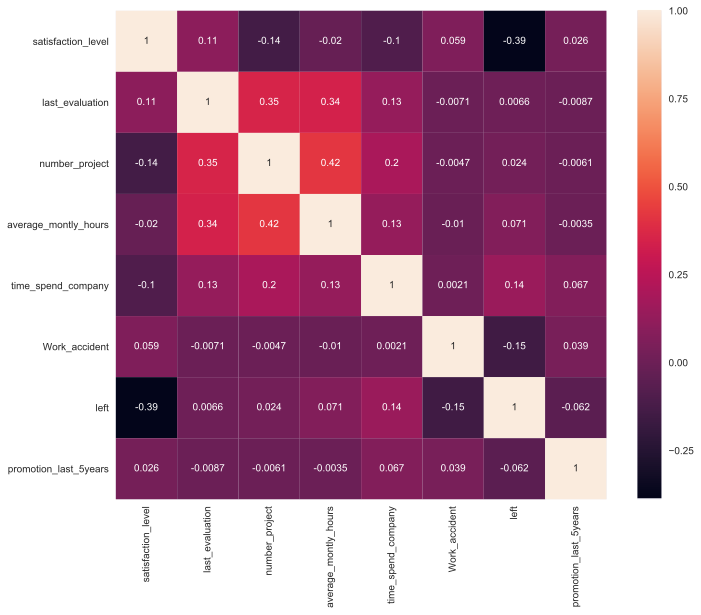

In [14]:
sns.heatmap(corr, annot=True,
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values);

Можно видеть, что индикатор left достаточно сильно негативно коррелирует с уровнем удовлетворенности работой, что вполне объяснимл. Также выше остальных left положительно коррелирует с стажем в компании. То есть, возможно, есть некая зависимость, что сотредники, которые дольше работают в компании, менее вероятнее уйдут.
Сильно положительно коррелируют количество рабочих часов в месяце и количество проектов. Интересна зависимость количества рабочих часов в месяц и уровень последней оценки работы.Можно предположить, что чем выше оценка, тем больше человек проводит времени на работе, то есть, можно предположить, что больше работают те, кому работа их работа нравится.

## Визуализировать несколько взаимосвязей между переменными

In [6]:
sns.pairplot(hr, vars=['satisfaction_level','number_project','promotion_last_5years','average_montly_hours']);